### Install Required Packages

We would be running `Stable Diffusion 2` so enable `GPU` under `View Resources > Change runtime type`

In [1]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-493d368e-5598-9ba2-3928-fe9c93237d24)


In [2]:
%%capture
!pip install diffusers
!pip install accelerate
!pip install daam==0.0.12
# !pip install git+https://github.com/RishiDarkDevil/daam-i2i.git
!pip install git+https://github.com/RishiDarkDevil/TITAN.git

In [3]:
%%capture
!git clone https://github.com/RishiDarkDevil/daam-i2i.git
%cd daam-i2i
!pip install -r requirements.txt

### Import Necessary Libraries

We will load the necessary libraries required for generating DAAM outputs for input prompts.

In [1]:
# %cd daam-i2i

/content/daam-i2i


In [2]:
# General
import requests
from io import BytesIO

# Plotting
from matplotlib import pyplot as plt

# Data Handling
import numpy as np

# Image Processing
import cv2
from PIL import Image

# Image Generation
from diffusers import StableDiffusionImg2ImgPipeline

# Heatmap generation
import daam
import daami2i

# Model
import torch

# annotations
import titan

### Load Model

In [3]:
DEVICE = 'cuda' # device

Now, let's load the `stabilityai/stable-diffusion-2-base` diffusion model.

In [4]:
STRENGTH = 0.3

In [5]:
model = StableDiffusionImg2ImgPipeline.from_pretrained('stabilityai/stable-diffusion-2-base')
model = model.to(DEVICE) # Set it to something else if needed, make sure DAAM supports that

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

### DAAM Image Attention

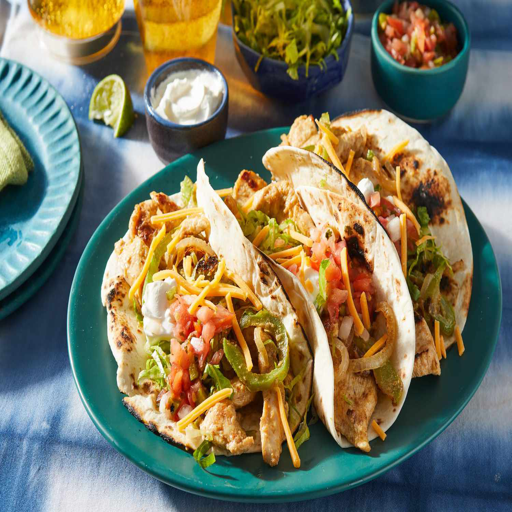

In [6]:
# Image
url = "https://www.foodandwine.com/thmb/ja3nlw1Mxefbc9ZcTFxJMgqaw54=/1500x0/filters:no_upscale():max_bytes(150000):strip_icc()/Easy-Chicken-Fajitas-FT-BLOG0822-2000-edc7c46e33e9444a81d60fc24bbbd69f.jpg"

response = requests.get(url)
init_img = Image.open(BytesIO(response.content)).convert("RGB")
# init_img = Image.open('img.png').convert("RGB")
init_img = init_img.resize((512, 512))
init_img

In [7]:
prompt = ['Plate']
objects = ['Plate']

In [8]:
# processed_prompt = titan.PromptHandler().clean_prompt(prompt)

In [9]:
# processed_prompt

In [8]:
with daam.trace(model) as daam_trc:
  with daami2i.trace(model, track_all=True) as daami2i_trc:
    output_image = model(prompt=prompt, init_image=init_img, strength=STRENGTH, guidance_scale=7.5).images[0]
    image_global_heat_map = daami2i_trc
    word_global_heat_map = daam_trc

  0%|          | 0/16 [00:00<?, ?it/s]

In [9]:
x = model.get_timesteps(50, STRENGTH, 'cuda')

In [10]:
x

tensor([301, 281, 261, 241, 221, 201, 181, 161, 141, 121, 101,  81,  61,  41,
         21,   1], device='cuda:0')

In [11]:
model.unet

UNet2DConditionModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (down_blocks): ModuleList(
    (0): CrossAttnDownBlock2D(
      (attentions): ModuleList(
        (0-1): 2 x Transformer2DModel(
          (norm): GroupNorm(32, 320, eps=1e-06, affine=True)
          (proj_in): Linear(in_features=320, out_features=320, bias=True)
          (transformer_blocks): ModuleList(
            (0): BasicTransformerBlock(
              (attn1): CrossAttention(
                (to_q): Linear(in_features=320, out_features=320, bias=False)
                (to_k): Linear(in_features=320, out_features=320, bias=False)
                (to_v): Linear(in_features=320, out_features=320, bias=False)
                (to_out): ModuleList(
         

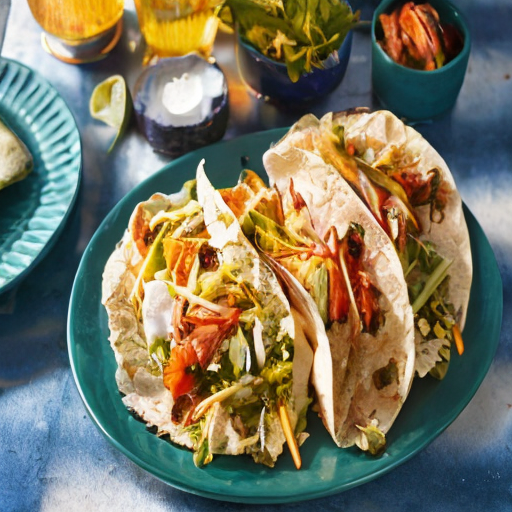

In [12]:
output_image

In [43]:
import os
names = [x for x in os.listdir('.') if x.endswith('pt') and x.startswith('1')]
digs = sorted([int(name.split('-')[-1].split('.')[0]) for name in names])

In [44]:
len(digs)

80

In [45]:
for dig in digs:
  t = torch.load(f'1-{dig}.pt')
  print(t.shape)

torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
torch.Size([10, 4096, 64])
t

In [ ]:
for dig in digs:
  t = torch.load(f'2-{dig}.pt')
  print(t.shape)

torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
torch.Size([2, 1024, 640])
t

In [ ]:
for dig in digs:
  t = torch.load(f'4-{dig}.pt')
  print(t.shape)

torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
torch.Size([2, 256, 1280])
t

In [ ]:
t.mean(0).shape

torch.Size([256, 1280])

In [50]:
import os
from tqdm import tqdm
from sklearn.manifold import TSNE

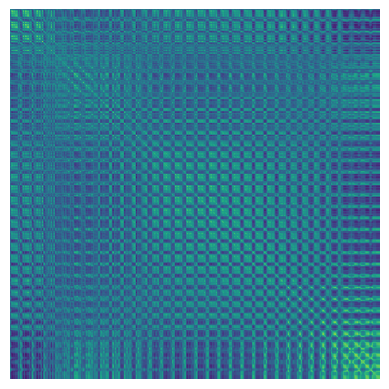

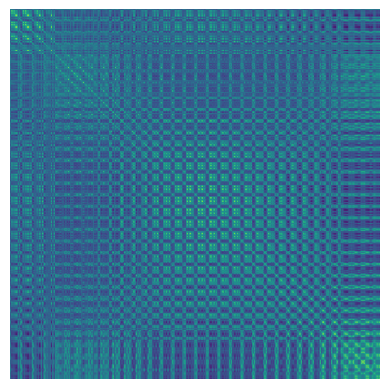

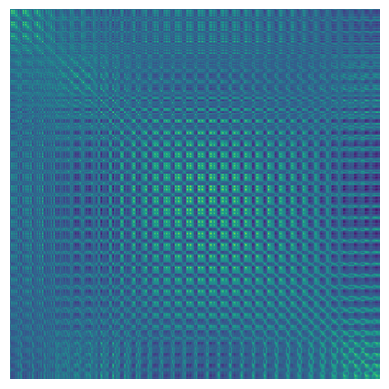

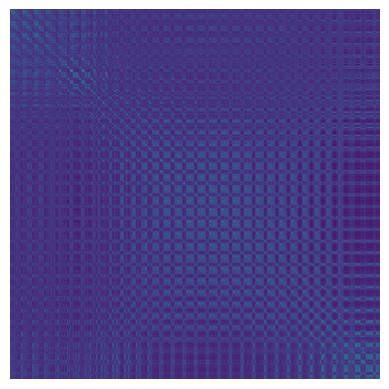

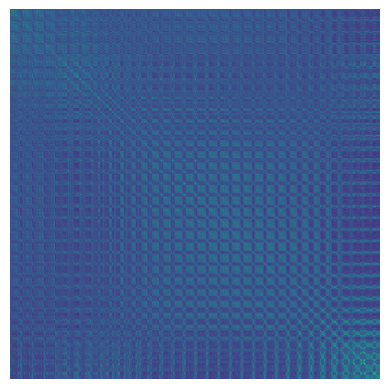

...

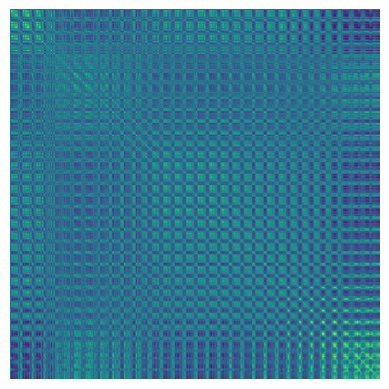

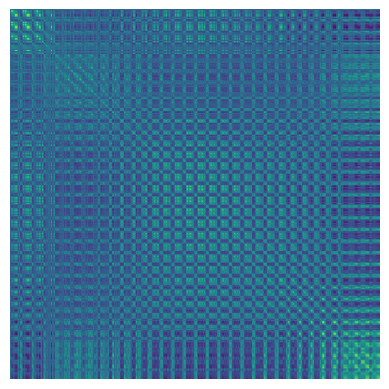

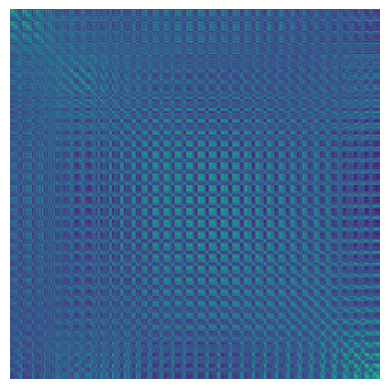

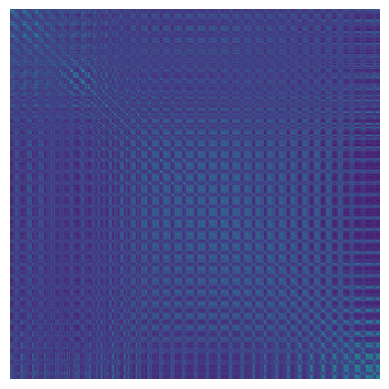

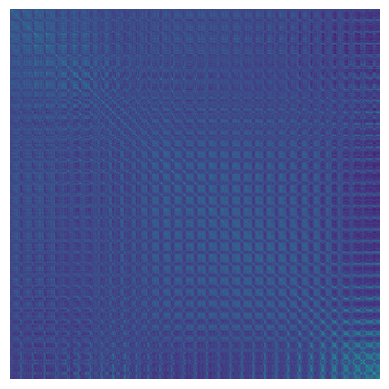

In [54]:
names = [x for x in os.listdir('.') if x.endswith('pt') and x.startswith('2')]
digs = sorted([int(name.split('-')[-1].split('.')[0]) for name in names])
for dig in digs[::4]:
  t = torch.load(f'2-{dig}.pt')
  t = t.cpu().mean(0)
  plt.imshow(torch.softmax(t @ t.T / torch.sqrt(torch.tensor(t.shape[-1])), -1))
  plt.axis('off')
  plt.show()

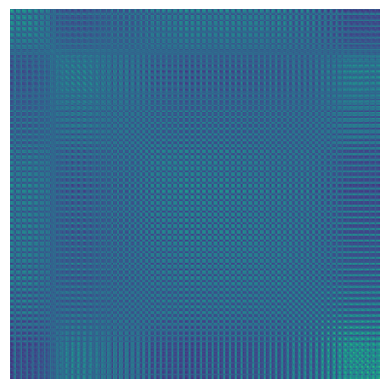

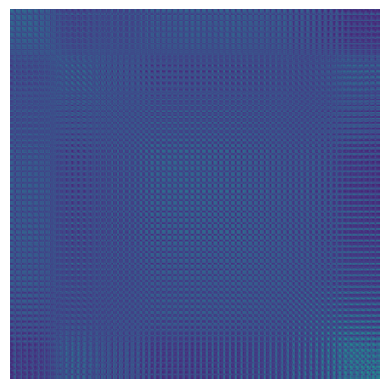

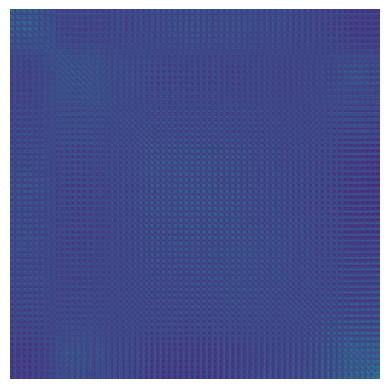

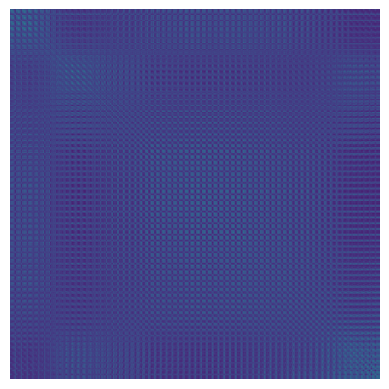

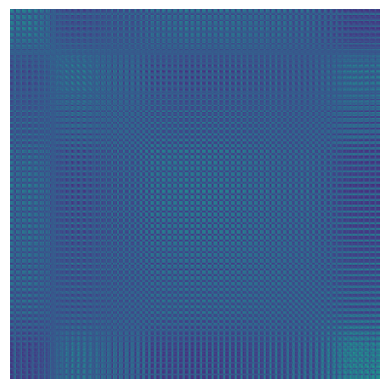

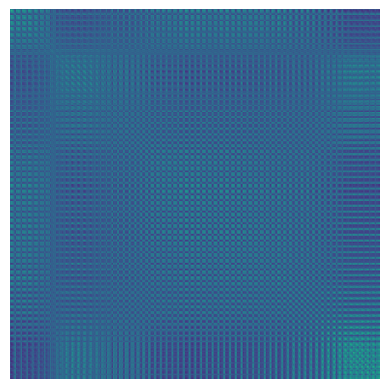

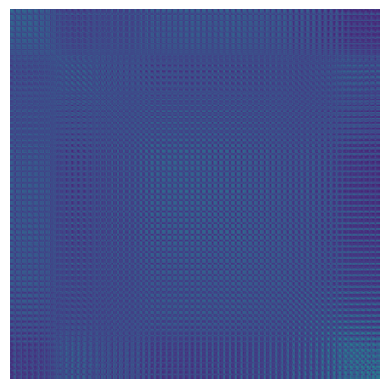

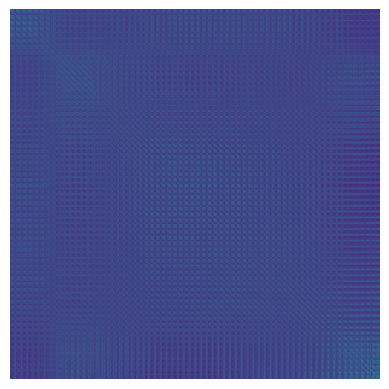

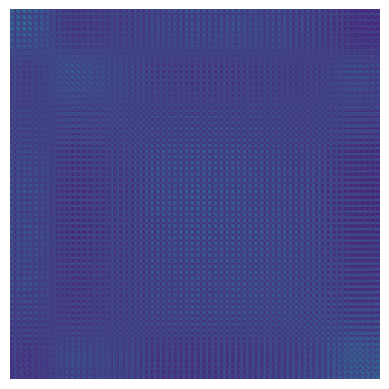

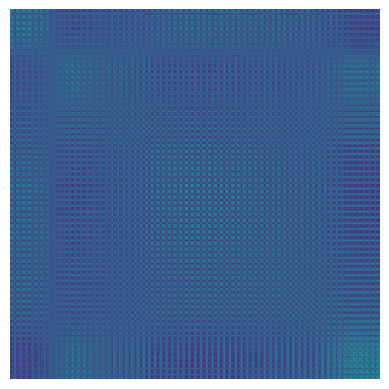

In [56]:
names = [x for x in os.listdir('.') if x.endswith('pt') and x.startswith('1')]
digs = sorted([int(name.split('-')[-1].split('.')[0]) for name in names])
for dig, dig_next in list(zip(digs, digs[1:]))[-10:]:
  t1 = torch.load(f'1-{dig}.pt')
  t2 = torch.load(f'1-{dig_next}.pt')
  t = (t2-t1).cpu().mean(0)
  plt.imshow(torch.softmax(t @ t.T / torch.sqrt(torch.tensor(t.shape[-1])), -1))
  plt.axis('off')
  plt.show()

In [ ]:
tsne = TSNE(n_components=2, learning_rate="auto", random_state=43, init="random")
tsne_embd = tsne.fit_transform(t.mean(0).detach().cpu().numpy())

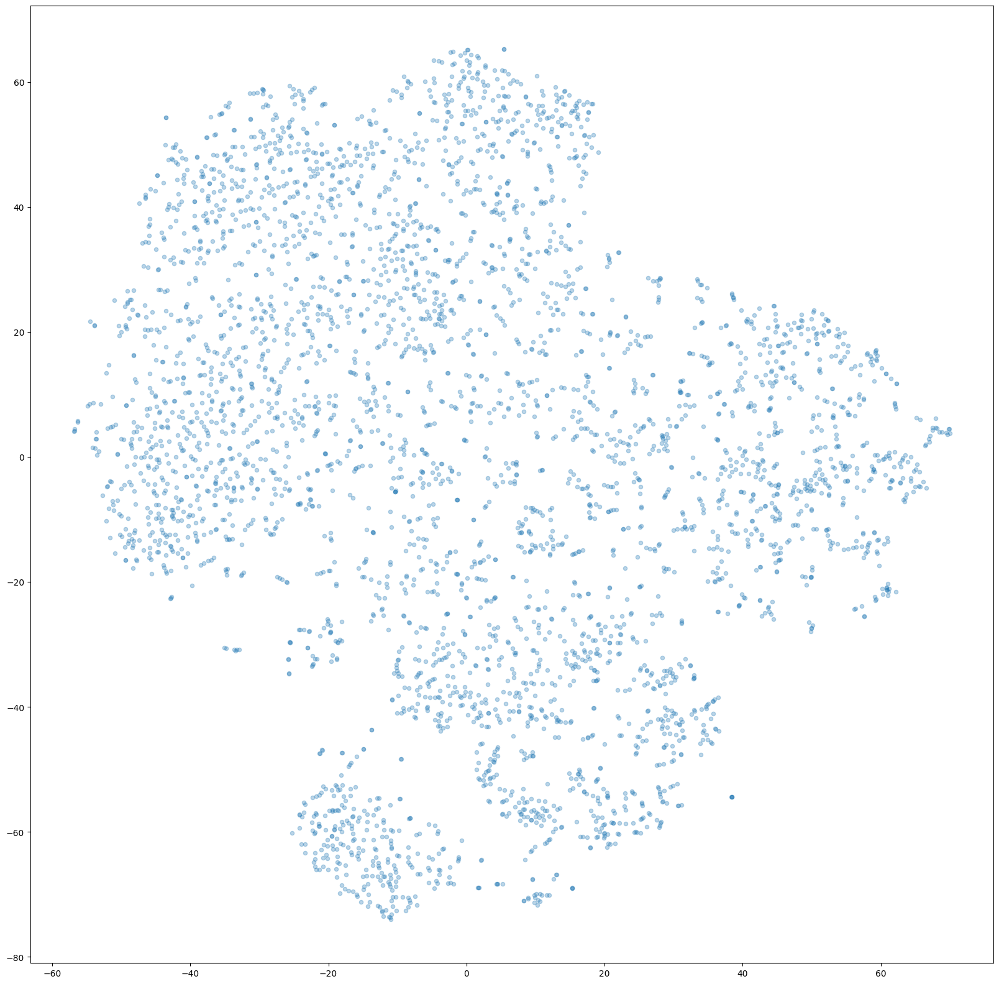

In [ ]:
# 4096
plt.figure(figsize=(20, 20))
labs = np.arange(t.shape[1])
plt.scatter(tsne_embd[:,0], tsne_embd[:,1], s=20, alpha=0.3)
plt.show()

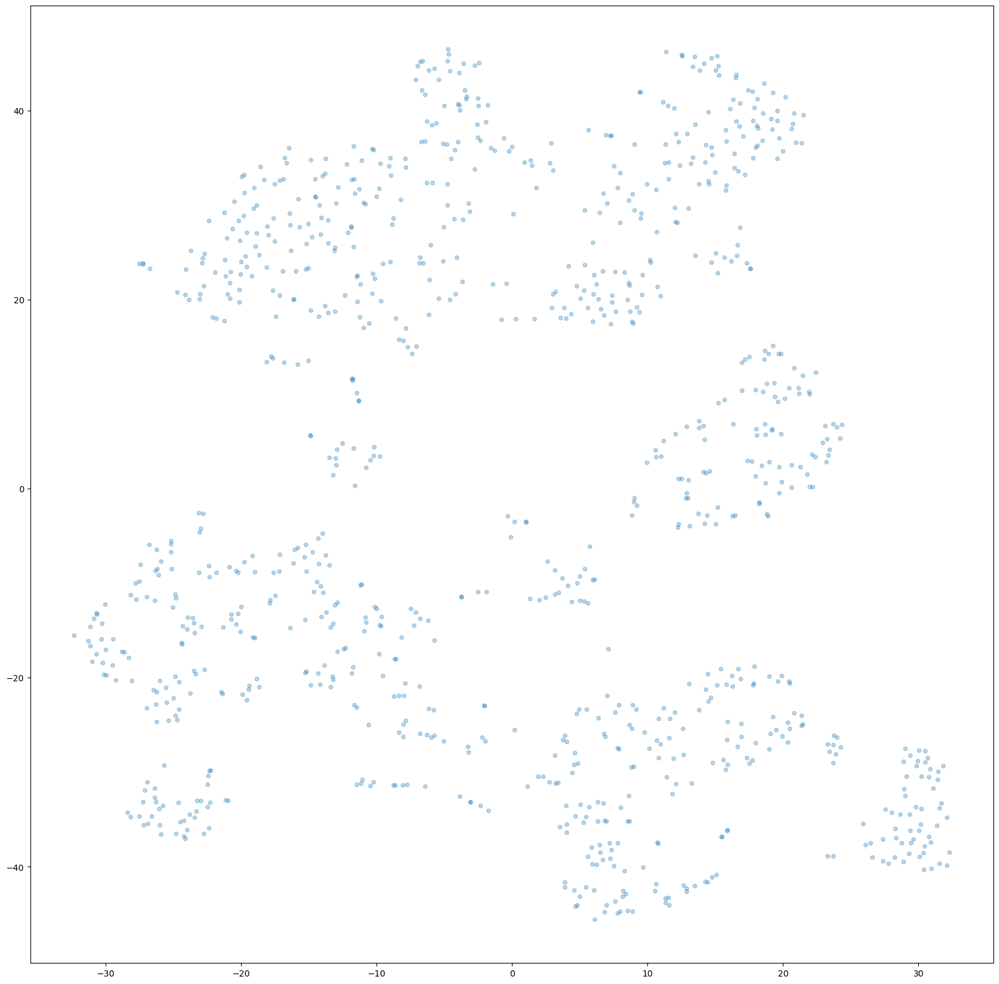

In [ ]:
# 1024
plt.figure(figsize=(20, 20))
labs = np.arange(t.shape[1])
plt.scatter(tsne_embd[:,0], tsne_embd[:,1], s=20, alpha=0.3)
plt.show()

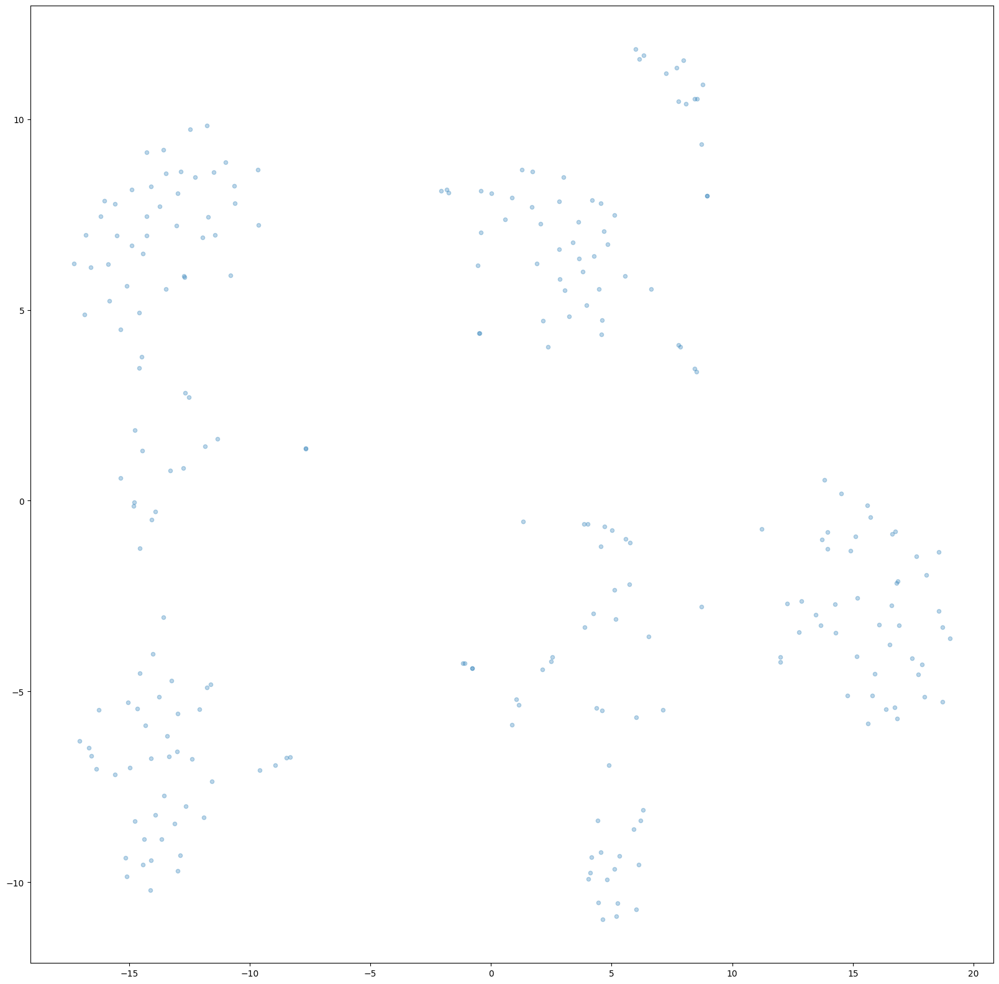

In [ ]:
# 256
plt.figure(figsize=(20, 20))
labs = np.arange(t.shape[1])
plt.scatter(tsne_embd[:,0], tsne_embd[:,1], s=20, alpha=0.3)
plt.show()

### Visualize Heatmaps

In [14]:
# Image2Image Attention Heatmap Aggregation for 1st Layer of UNet
image_global_heat_map4 = image_global_heat_map.compute_global_heat_map([4], None, None)

In [15]:
# Image2Image Attention Heatmap Aggregation for 1st Layer of UNet
image_global_heat_map2 = image_global_heat_map.compute_global_heat_map([2], None, None)

In [16]:
# Image2Image Attention Heatmap Aggregation for 1st Layer of UNet
image_global_heat_map = image_global_heat_map.compute_global_heat_map([1], None, None)
# Text2Image Attention Heatmap Aggregation for all Layers of UNet
word_global_heat_map = word_global_heat_map.compute_global_heat_map(None, None, None)

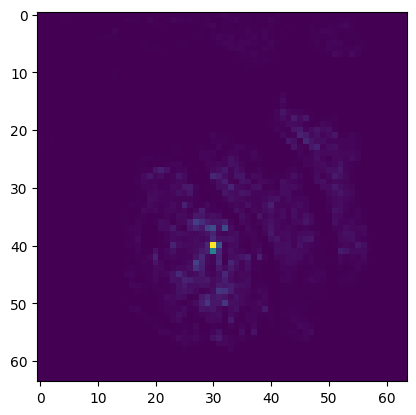

In [18]:
plt.imshow(image_global_heat_map.compute_pixel_heat_map(40*64+30).heatmap)

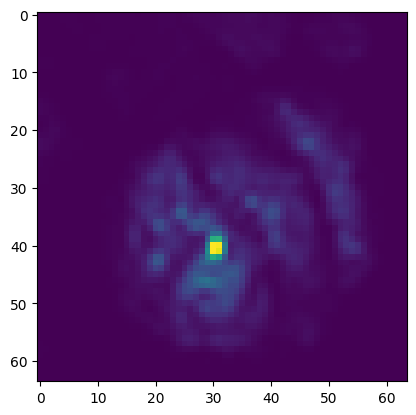

In [19]:
plt.imshow(image_global_heat_map2.compute_pixel_heat_map(40*64+30).heatmap)

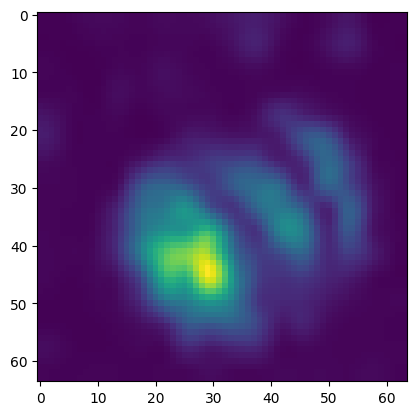

In [20]:
plt.imshow(image_global_heat_map4.compute_pixel_heat_map(40*64+30).heatmap)

In [ ]:
word_heatmap = word_global_heat_map.compute_word_heat_map(objects[-1]).heatmap

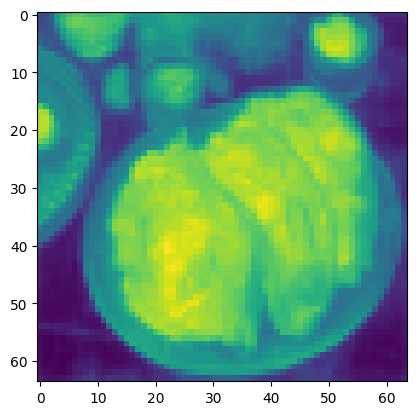

In [ ]:
# Text Guided
plt.imshow(image_global_heat_map.compute_guided_heat_map(word_heatmap).heatmap)

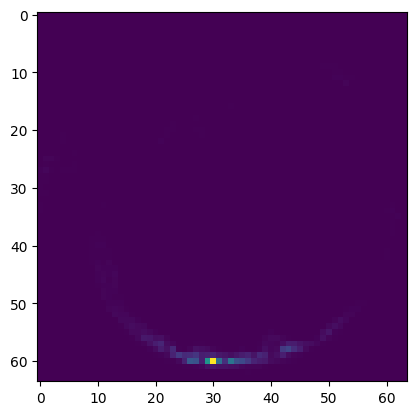

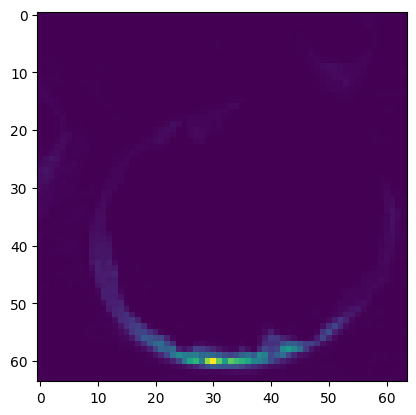

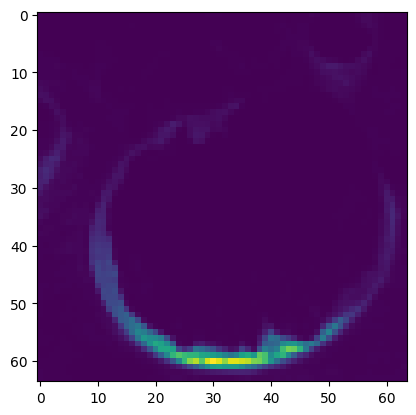

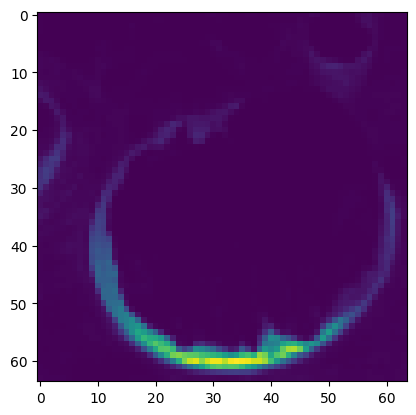

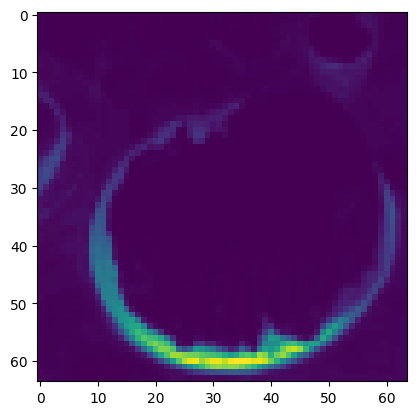

...

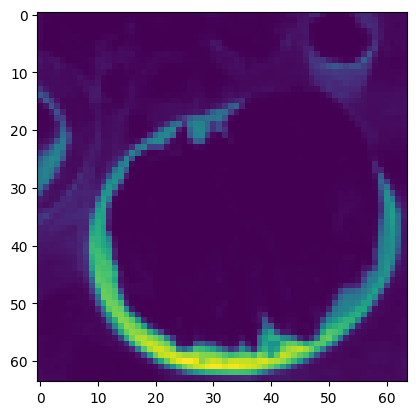

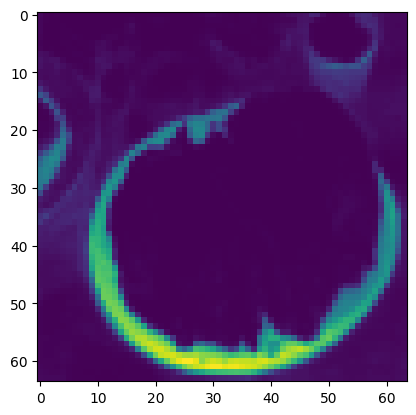

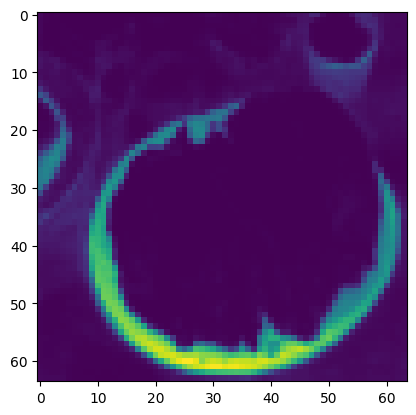

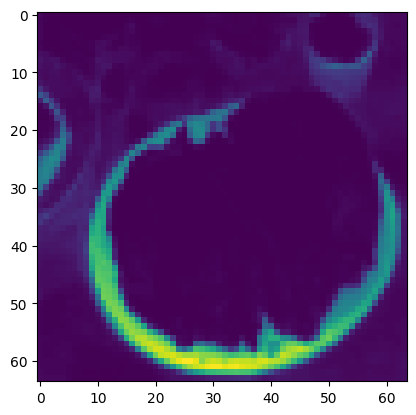

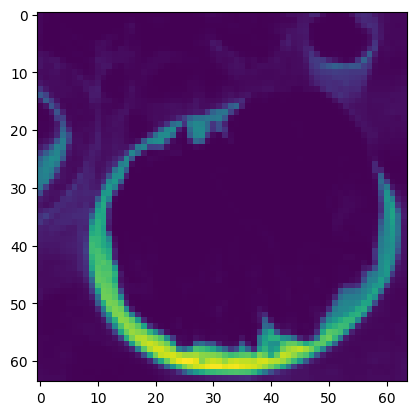

In [30]:
# Pixel Attention Diffusion Image diffusion
NUM_DIFFUSE = 20
PIXEL_ID = 60*64 + 30 # Enter Pixel ID
heatmap = image_global_heat_map.compute_pixel_diffused_heat_map(PIXEL_ID, 'thresholding', NUM_DIFFUSE, 0.009, True)

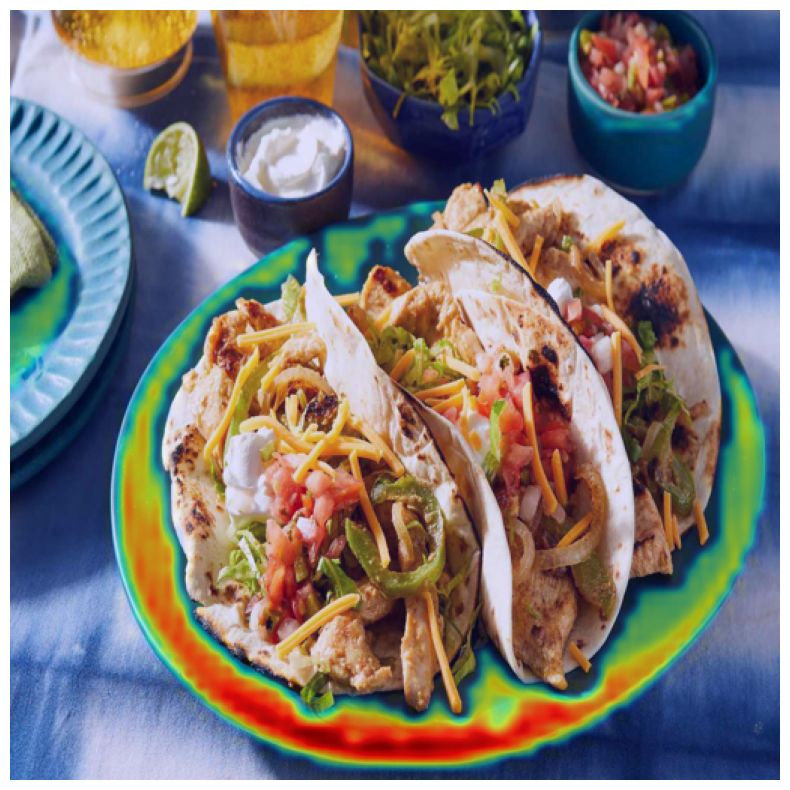

In [31]:
heatmap.plot_overlay(init_img)

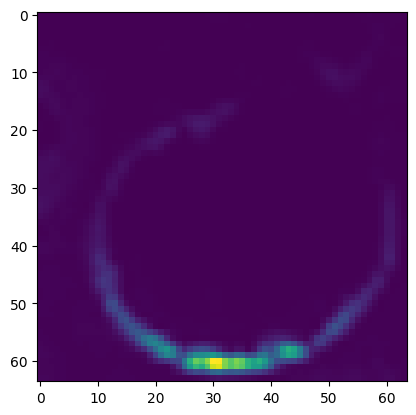

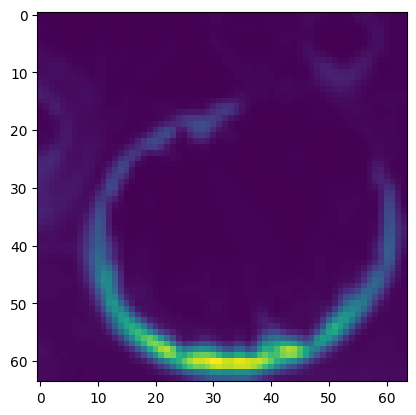

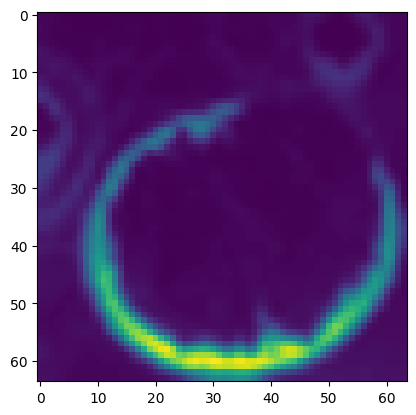

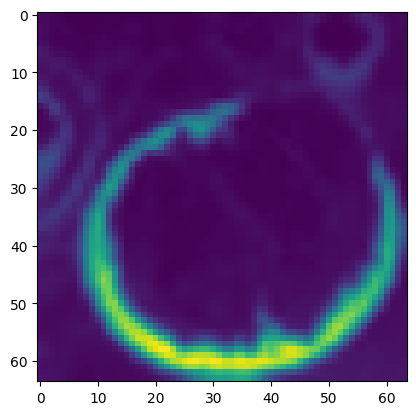

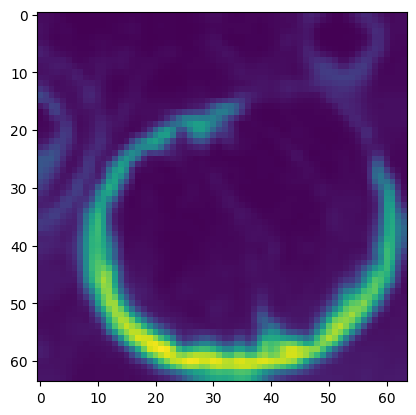

...

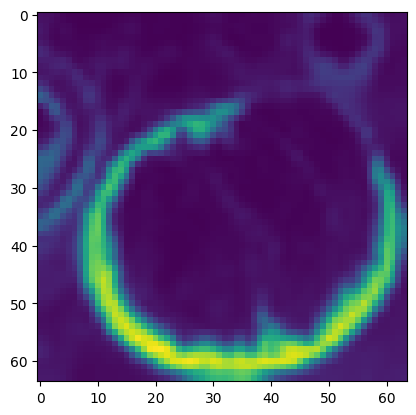

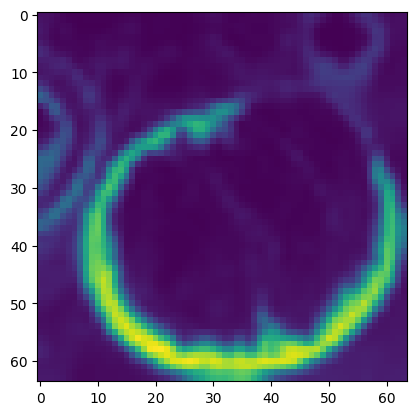

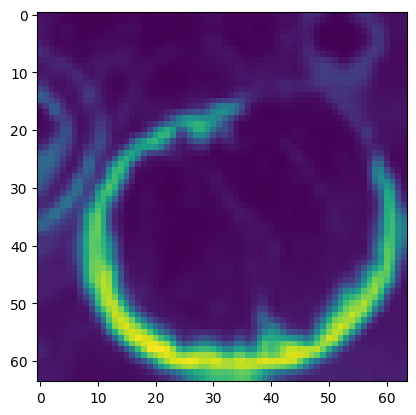

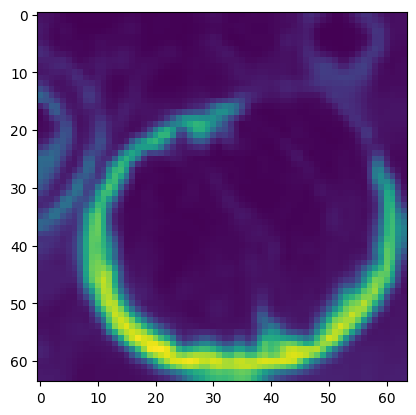

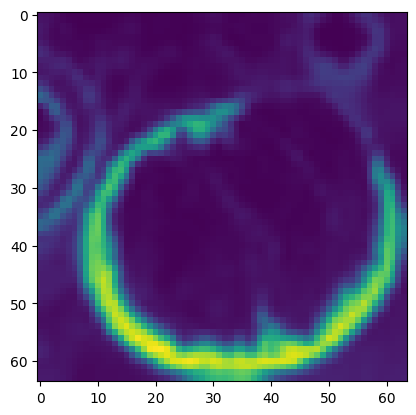

In [28]:
# Pixel Attention Diffusion Image diffusion
NUM_DIFFUSE = 20
PIXEL_ID = 60*64 + 30 # Enter Pixel ID
heatmap = image_global_heat_map2.compute_pixel_diffused_heat_map(PIXEL_ID, 'thresholding', NUM_DIFFUSE, 0.02, True)

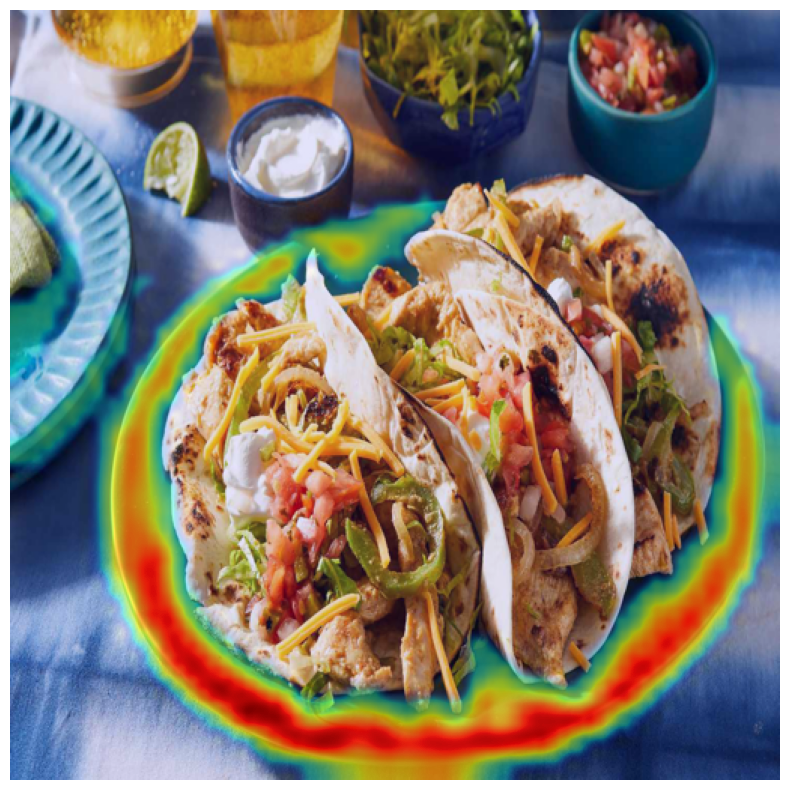

In [29]:
heatmap.plot_overlay(init_img)

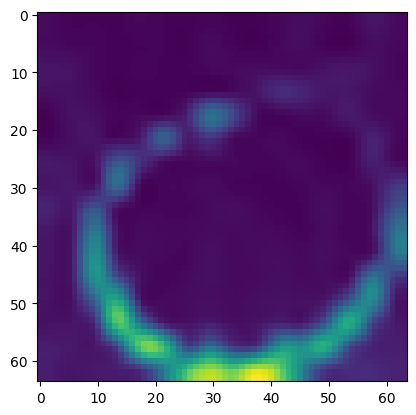

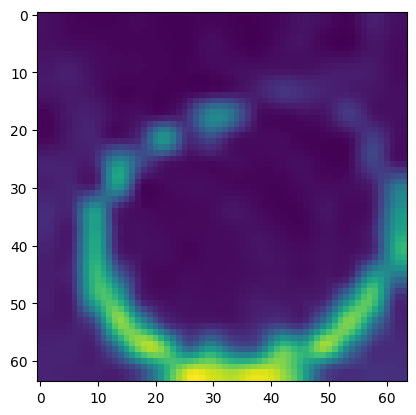

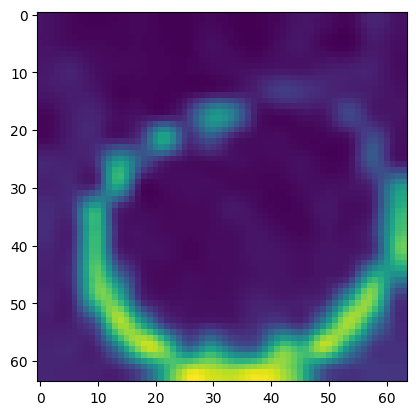

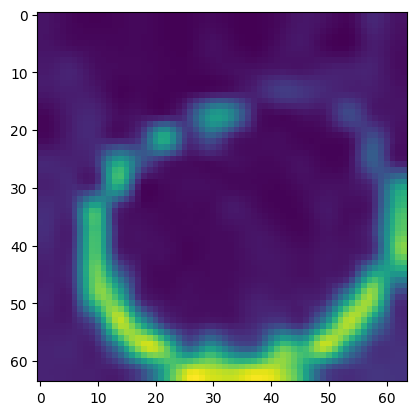

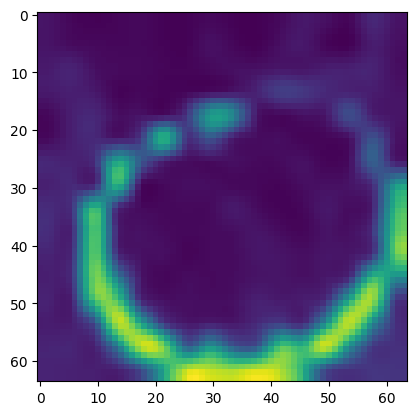

...

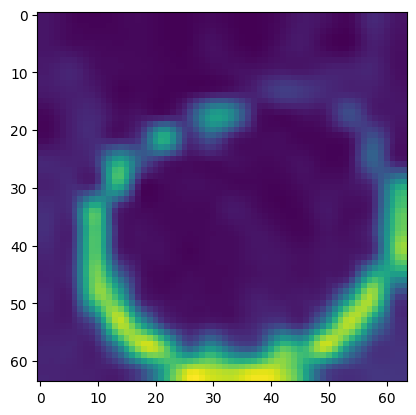

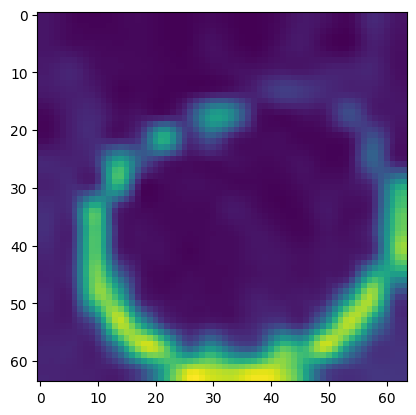

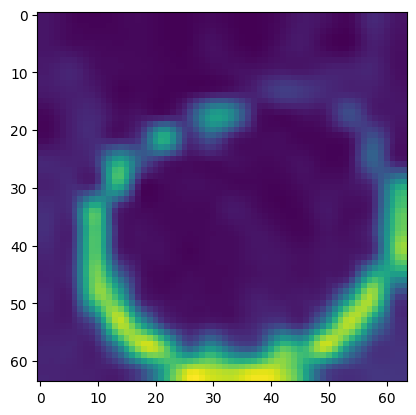

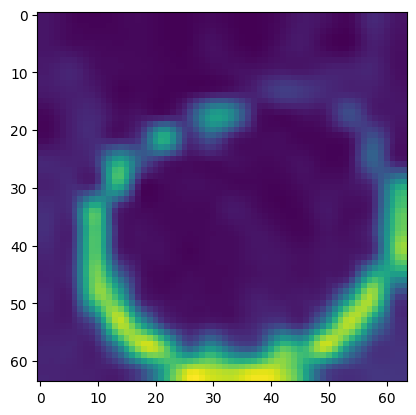

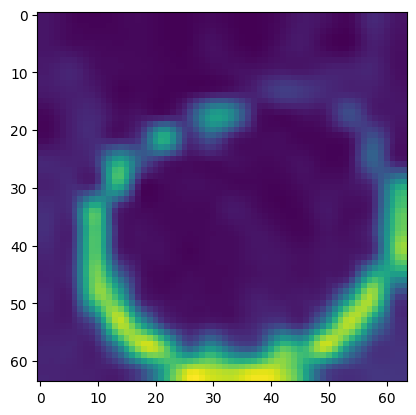

In [26]:
# Pixel Attention Diffusion Image diffusion
NUM_DIFFUSE = 20
PIXEL_ID = 60*64 + 30 # Enter Pixel ID
heatmap = image_global_heat_map4.compute_pixel_diffused_heat_map(PIXEL_ID, 'thresholding', NUM_DIFFUSE, 0.2, True)

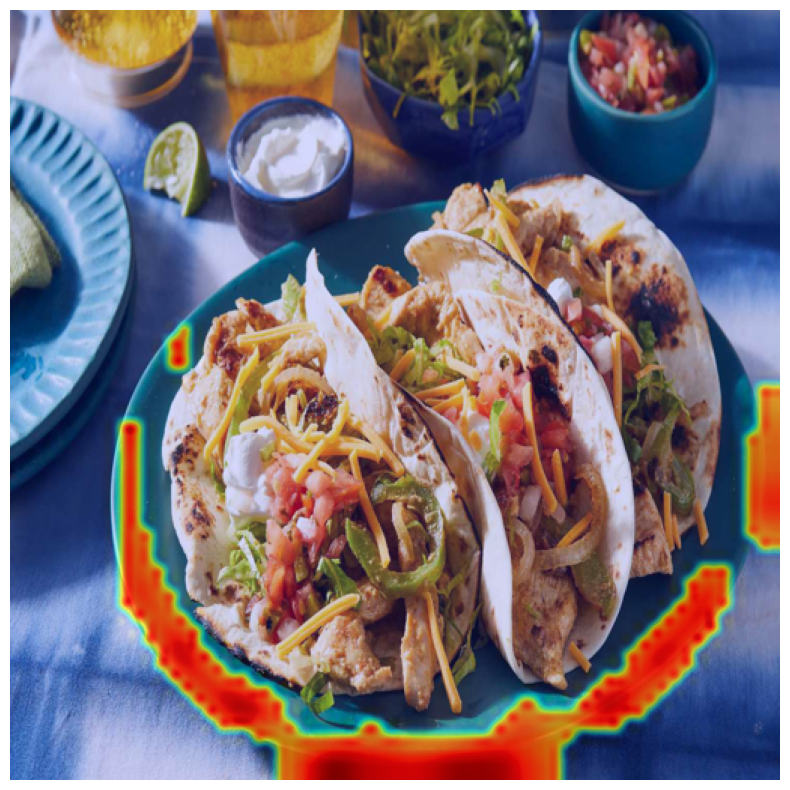

In [27]:
heatmap.plot_overlay(init_img)

In [32]:
heatmap = image_global_heat_map.compute_diffused_heat_map('thresholding', NUM_DIFFUSE, 0.009)

100%|██████████| 20/20 [00:26<00:00,  1.31s/it]


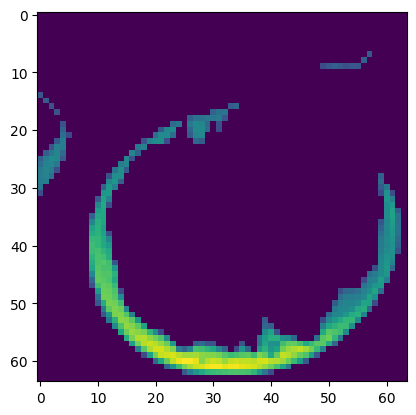

In [33]:
plt.imshow(heatmap.compute_pixel_heat_map(PIXEL_ID).heatmap)

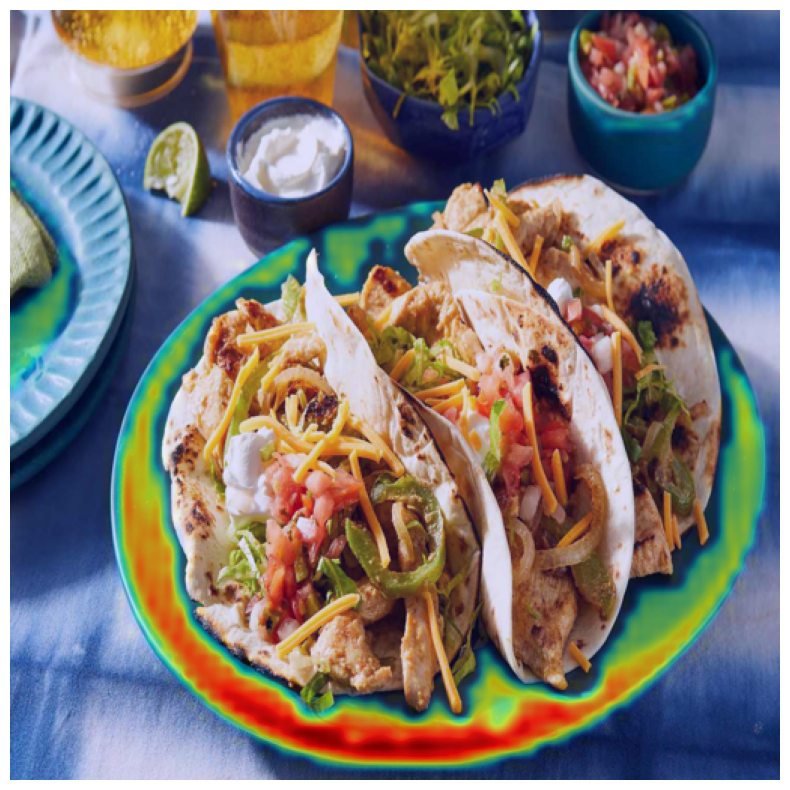

In [34]:
heatmap.compute_pixel_heat_map(PIXEL_ID).plot_overlay(init_img)

In [35]:
object_annotator = titan.ObjectAnnotator()

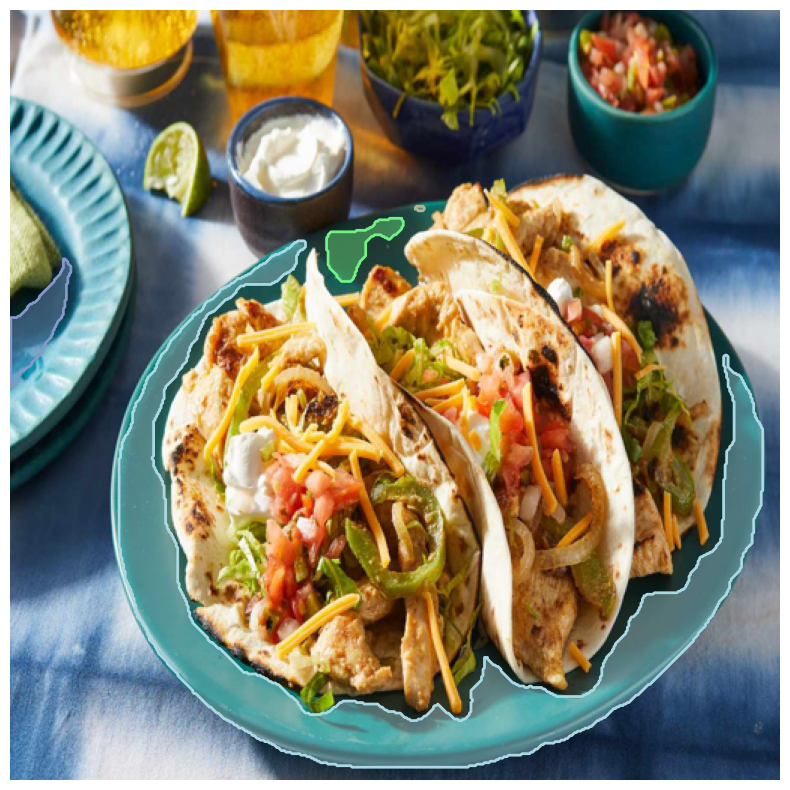

In [36]:
ann = object_annotator.wordheatmap_to_annotations(heatmap.compute_pixel_heat_map(PIXEL_ID).expand_as(output_image).numpy(), use_nms=False, skip_small_filters=True)
object_annotator.show_annotations(np.asarray(init_img), ann, draw_bbox=False)

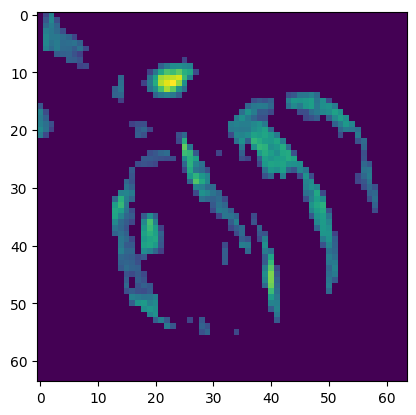

In [37]:
plt.imshow(heatmap.compute_pixel_heat_map(40*64+19).heatmap)

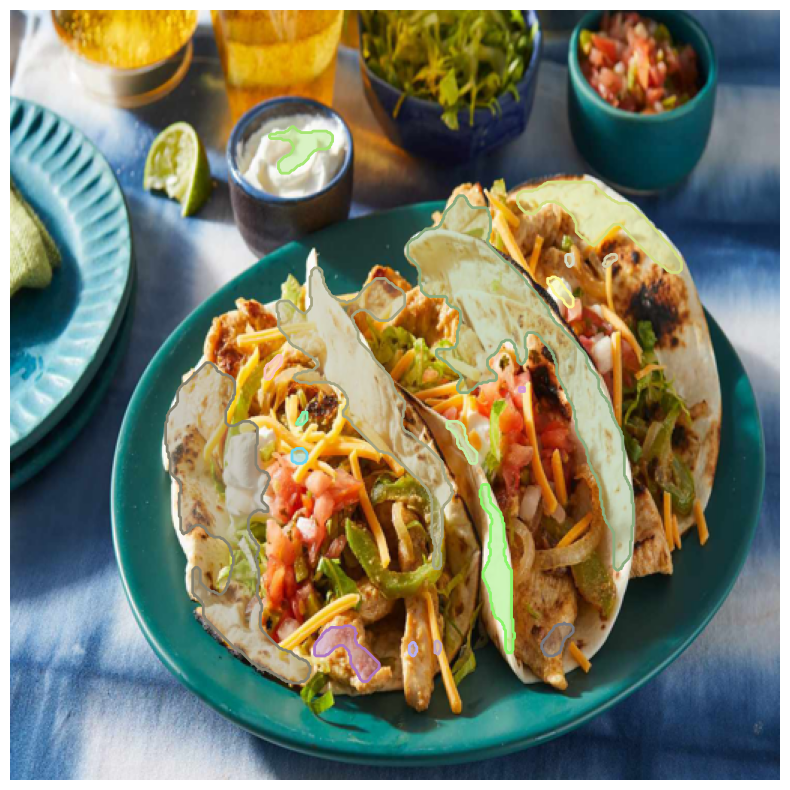

In [ ]:
ann = object_annotator.wordheatmap_to_annotations(heatmap.compute_pixel_heat_map(40*64+19).expand_as(output_image).numpy(), use_nms=False, skip_small_filters=True)
object_annotator.show_annotations(np.asarray(init_img), ann, draw_bbox=False)

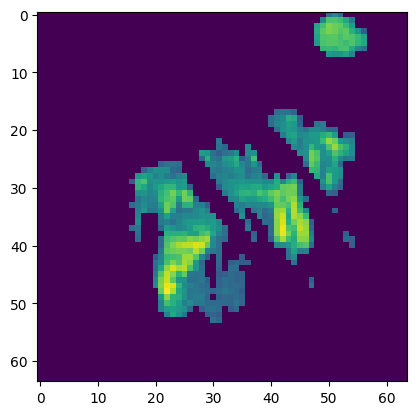

In [38]:
plt.imshow(heatmap.compute_pixel_heat_map(40*64+30).heatmap)

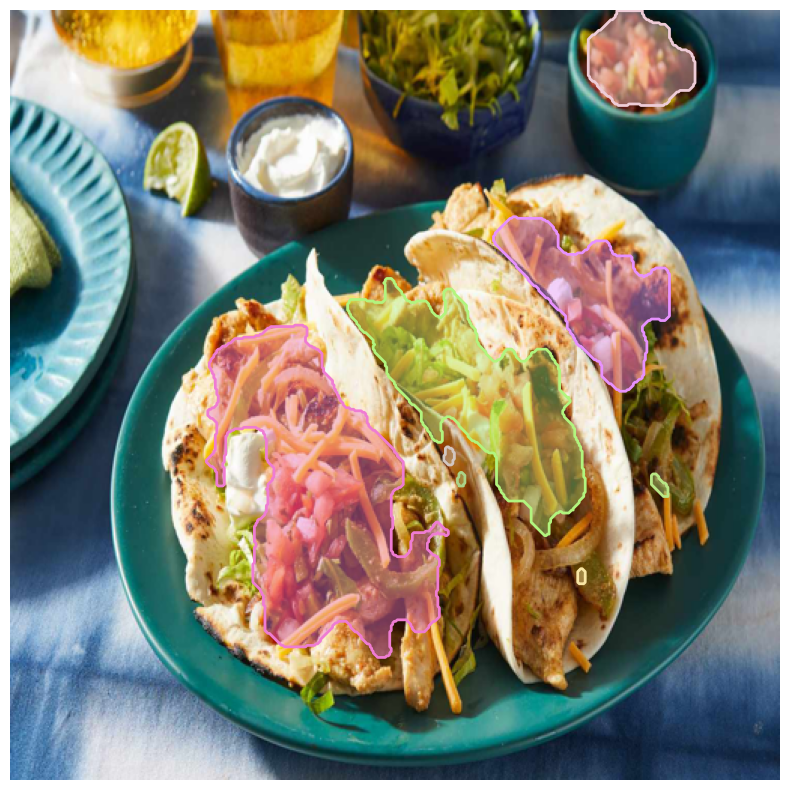

In [39]:
ann = object_annotator.wordheatmap_to_annotations(heatmap.compute_pixel_heat_map(40*64+30).expand_as(output_image).numpy(), use_nms=False, skip_small_filters=True)
object_annotator.show_annotations(np.asarray(init_img), ann, draw_bbox=False)

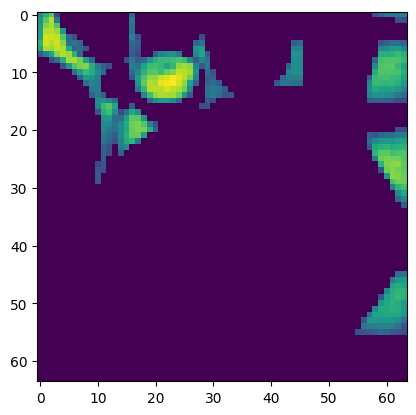

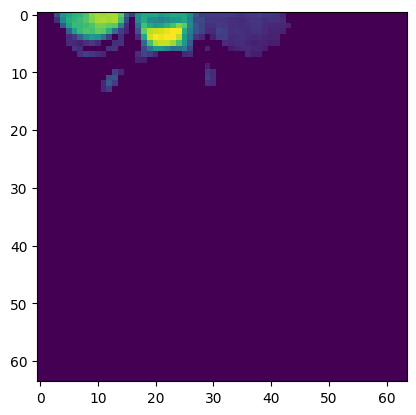

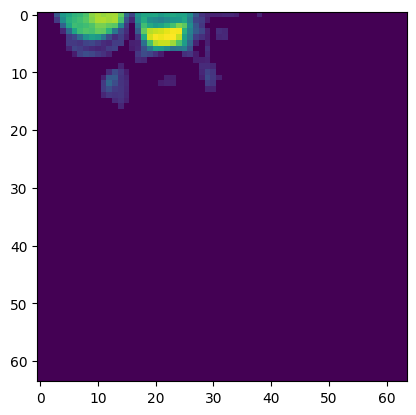

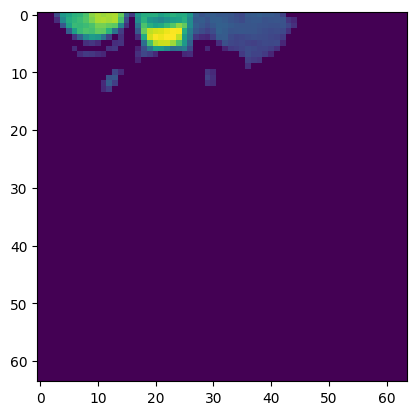

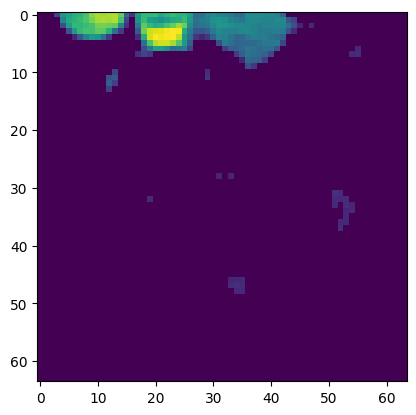

...

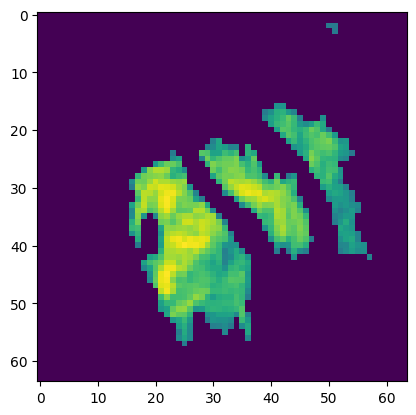

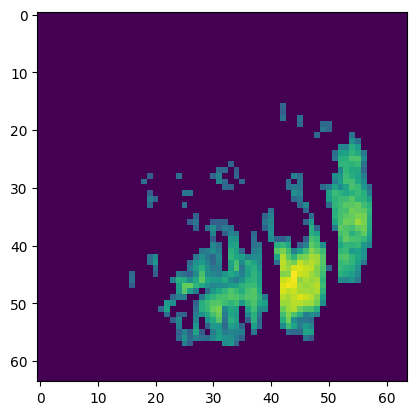

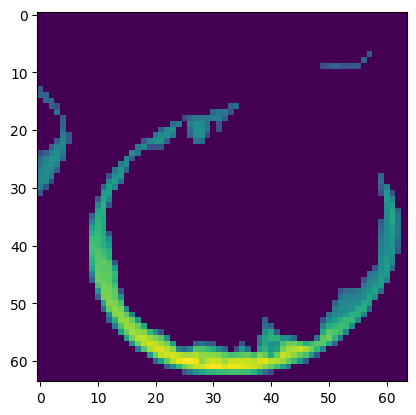

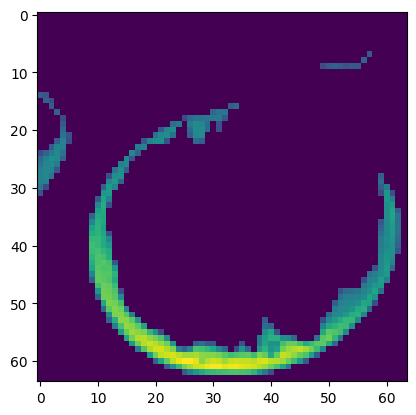

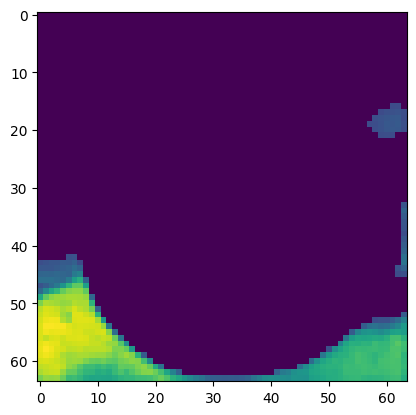

In [40]:
for i in range(0, 64, 8):
  for j in range(0, 64, 8):
    plt.imshow(heatmap.compute_pixel_heat_map(i*64+j).heatmap)
    plt.show()